# Pre Trabajo Práctico 1
##### Daniel Caicedo - Ignacio Chiapella - Miguel Guerrero - Juan Knebel

In [2]:
# Para visuzalización en notebook
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (8,6)
mpl.rcParams['font.size'] = 22
from IPython.display import Audio, Markdown, Image
import seaborn as sns

# Números y Datos
import numpy as np
import pandas as pd

# Archivos
import urllib.request
import glob

# Machine learning
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import Normalizer

## Carga los nombres de los archivos audio_analysis y metadata
Una vez generados los archivos, se puede saltear esta parte

In [11]:
audio_analysis_files_timbre = glob.glob('../data/audio_analysis/timbre/*')
audio_analysis_files_pitches = glob.glob('../data/audio_analysis/pitches/*')

In [12]:
metadata = pd.read_csv("../data/audio_analysis/metadata.csv", index_col='id')
metadata_clean = metadata.loc[:,['album','artists','name','popularity','genre']]

## Generar los nuevos dataframes

In [13]:
cols = ["0", "1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11"]
# Para generar los indices en el dataframe con el id de las canciones, tomo los la ruta
#donde se encuentran los archivos y quito los subdirectorios (/) y la extension .csv
index = list(map(lambda x: x.split("/")[-1].split(".")[0], audio_analysis_files_timbre))
df_timbres_avg = pd.DataFrame(index=index, columns=cols)
df_pitches_avg = pd.DataFrame(index=index, columns=cols)
df_timbres_avg.index.name = "id"
df_pitches_avg.index.name = "id"

df_timbres_std_dev = pd.DataFrame(index=index, columns=cols)
df_pitches_std_dev = pd.DataFrame(index=index, columns=cols)
df_timbres_std_dev.index.name = "id"
df_pitches_std_dev.index.name = "id"

## Para cada archivo voy guardar el promedio y desvio para cada nota

### Timbre

In [14]:
for filename in audio_analysis_files_timbre:
    audio_analysis = pd.read_csv(filename, index_col='start')
    file_index = filename.split("/")[-1].split(".")[0]
    df_timbres_avg.loc[file_index] = np.mean(audio_analysis)
    df_timbres_std_dev.loc[file_index] =  np.std(audio_analysis)

### Pitches

In [15]:
for filename in audio_analysis_files_pitches:
    audio_analysis = pd.read_csv(filename, index_col='start')
    file_index = filename.split("/")[-1].split(".")[0]
    df_pitches_avg.loc[file_index] = np.mean(audio_analysis)
    df_pitches_std_dev.loc[file_index] =  np.std(audio_analysis)

### Guardo los archivos
Para no tener que estar recalculando, guardo los 4 archivos con el promedio y el desvio standard

In [17]:
df_timbres_avg.to_csv("../data/audio_analysis/timbre_avg.csv")
df_timbres_std_dev.to_csv("../data/audio_analysis/timbre_std_dev.csv")
df_pitches_avg.to_csv("../data/audio_analysis/pitches_avg.csv")
df_pitches_std_dev.to_csv("../data/audio_analysis/pitches_std_dev.csv")

## Gráficos sin estandarizar y sin normalizar

Comenzar desde aca si ya se tienen los arhivos generados previamente

In [3]:
metadata = pd.read_csv("../data/audio_analysis/metadata.csv", index_col='id')
metadata_clean = metadata.loc[:,['album','artists','name','popularity','genre']]

df_timbres_avg = pd.read_csv("../data/audio_analysis/timbre_avg.csv", index_col='id')
df_timbres_std_dev = pd.read_csv("../data/audio_analysis/timbre_std_dev.csv", index_col='id')
df_pitches_avg = pd.read_csv("../data/audio_analysis/pitches_avg.csv", index_col='id')
df_pitches_std_dev = pd.read_csv("../data/audio_analysis/pitches_std_dev.csv", index_col='id')

### Scatter matrix

#### Concateno con la metadata y utilizo el genero para generar el scatter

In [4]:
## Agrego el Género a los features
timbres_avg_genre = pd.concat([df_timbres_avg,metadata_clean.genre],axis=1,sort=True,join="inner")
timbres_std_genre = pd.concat([df_timbres_std_dev,metadata_clean.genre],axis=1,sort=True,join="inner")
pitches_avg_genre = pd.concat([df_pitches_avg,metadata_clean.genre],axis=1,sort=True,join="inner")
pitches_std_genre = pd.concat([df_pitches_std_dev,metadata_clean.genre],axis=1,sort=True,join="inner")

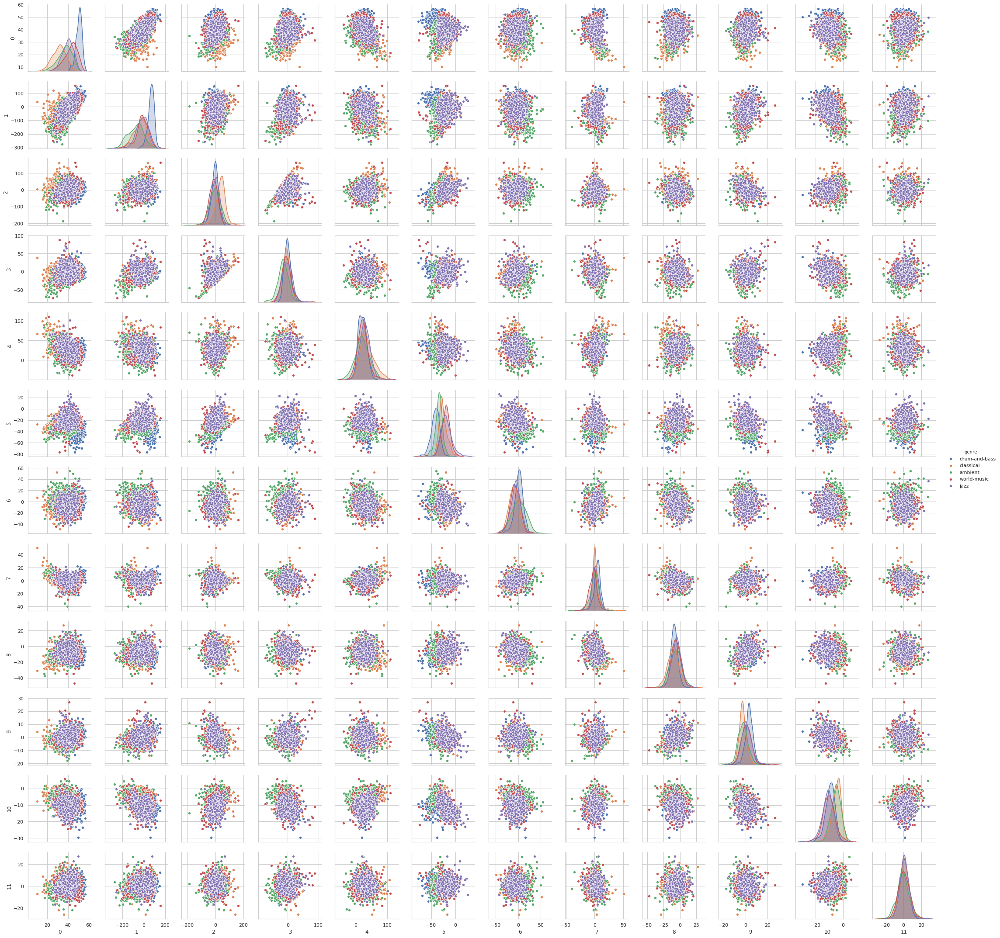

In [5]:
# Scatter timbres_avg
sns.set(style="whitegrid")
sns_plot = sns.pairplot(timbres_avg_genre,hue='genre')
sns_plot.savefig("scatter-aa-timbres-avg.png")

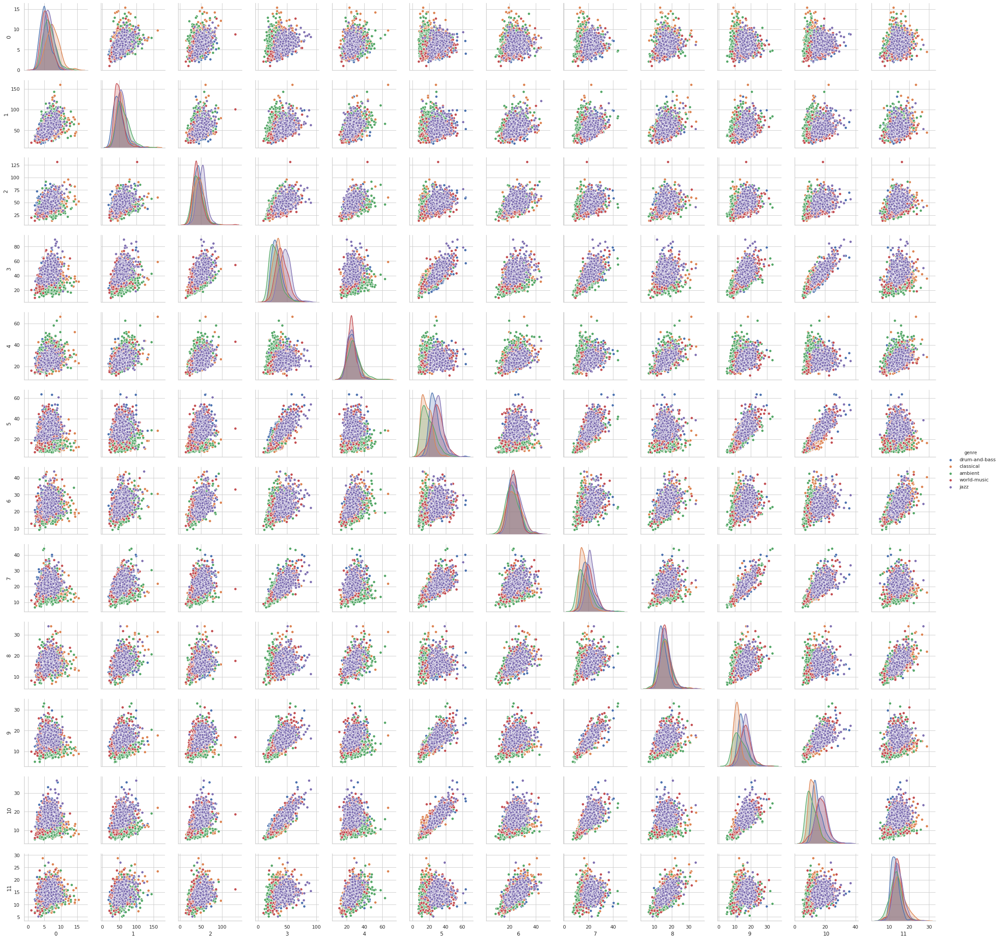

In [6]:
# Scatter timbres_std_dev
sns.set(style="whitegrid")
sns_plot = sns.pairplot(timbres_std_genre,hue='genre')
sns_plot.savefig("scatter-aa-timbres-std.png")

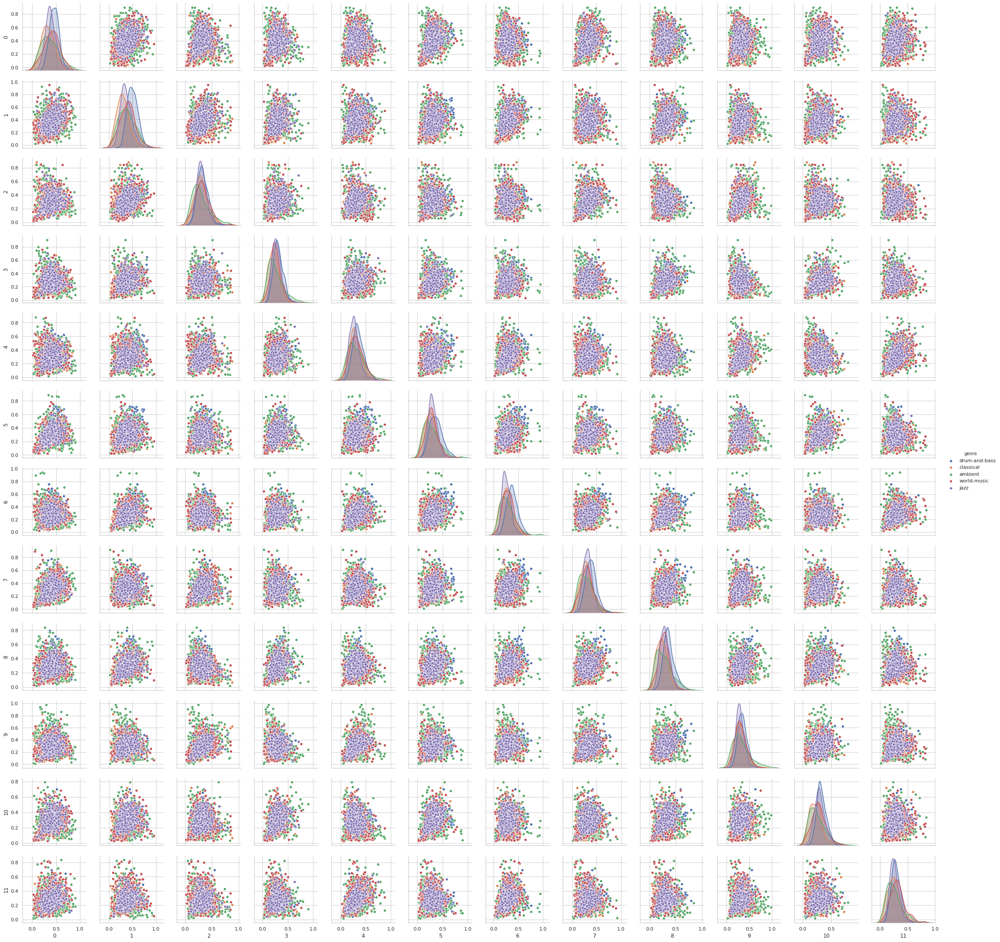

In [7]:
# Scatter pitches_avg
sns.set(style="whitegrid")
sns_plot = sns.pairplot(pitches_avg_genre,hue='genre')
sns_plot.savefig("scatter-aa-pitches-avg.png")

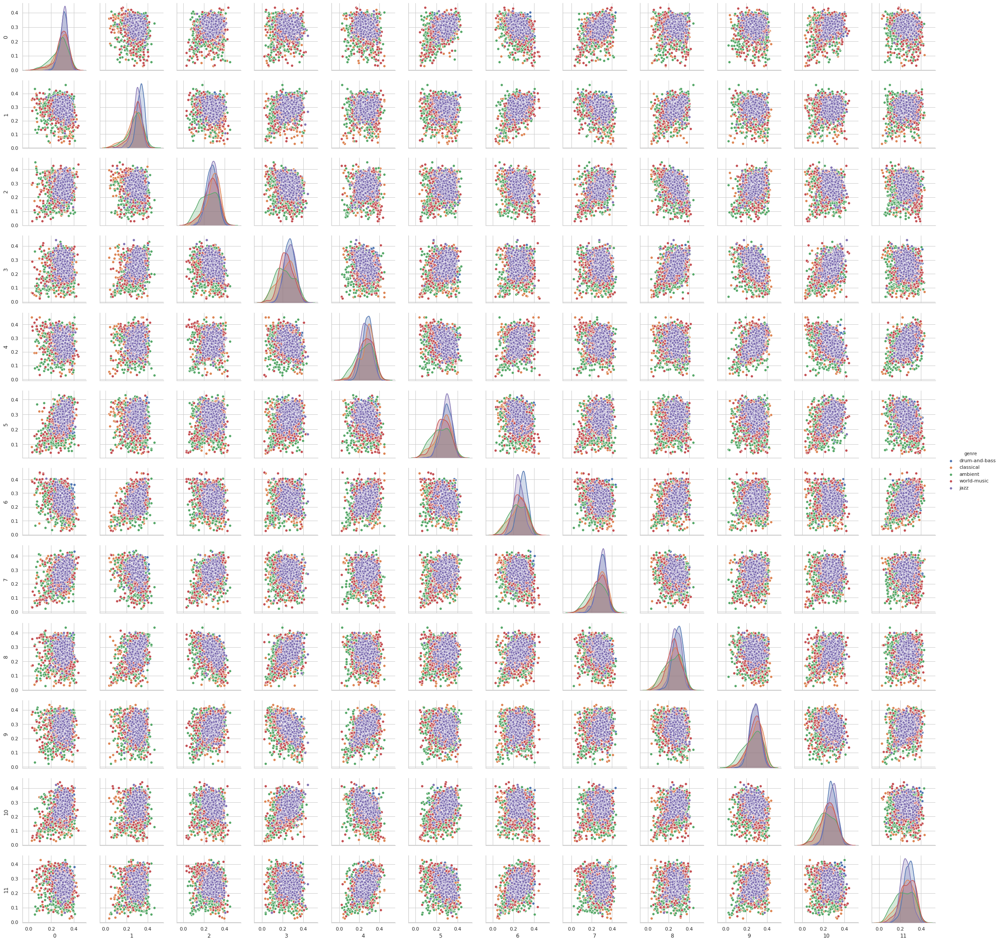

In [8]:
# Scatter pitches_std
sns.set(style="whitegrid")
sns_plot = sns.pairplot(pitches_std_genre,hue='genre')
sns_plot.savefig("scatter-aa-pitches-std.png")

### Box plot

#### Estandarizo los dataframes

In [25]:
ss = StandardScaler()
df_timbres_avg_standard = pd.DataFrame(ss.fit_transform(df_timbres_avg), index=df_timbres_avg.index, columns=df_timbres_avg.columns)
df_timbres_std_standard = pd.DataFrame(ss.fit_transform(df_timbres_std_dev), index=df_timbres_std_dev.index, columns=df_timbres_std_dev.columns)
df_pitches_avg_standard = pd.DataFrame(ss.fit_transform(df_pitches_avg), index=df_pitches_avg.index, columns=df_pitches_avg.columns)
df_pitches_std_standard = pd.DataFrame(ss.fit_transform(df_pitches_std_dev), index=df_pitches_std_dev.index, columns=df_pitches_std_dev.columns)

/home/ignacio/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning: Data with input dtype object were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/home/ignacio/anaconda3/lib/python3.7/site-packages/sklearn/base.py:464: DataConversionWarning: Data with input dtype object were all converted to float64 by StandardScaler.
  return self.fit(X, **fit_params).transform(X)
/home/ignacio/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning: Data with input dtype object were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/home/ignacio/anaconda3/lib/python3.7/site-packages/sklearn/base.py:464: DataConversionWarning: Data with input dtype object were all converted to float64 by StandardScaler.
  return self.fit(X, **fit_params).transform(X)
/home/ignacio/anaconda3/lib/python3.7/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning: Data w

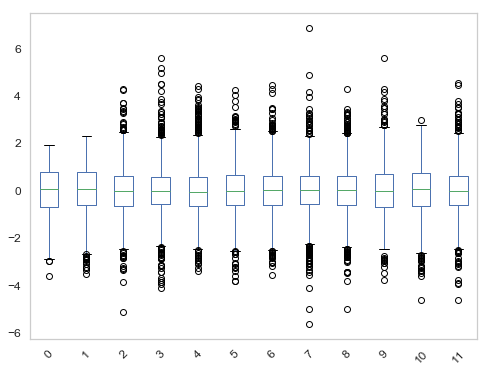

In [26]:
# Boxplot timbres_avg
df_timbres_avg_standard.boxplot(grid=False, rot=45, fontsize=12)

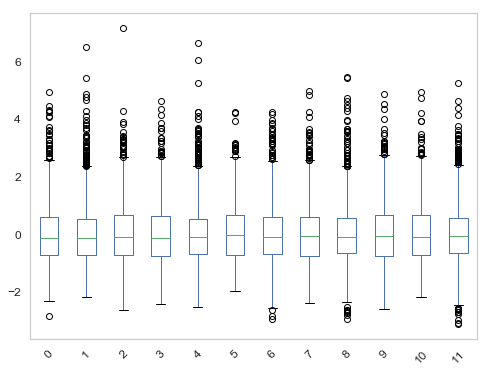

In [27]:
# Boxplot timbres_std
df_timbres_std_standard.boxplot(grid=False, rot=45, fontsize=12)

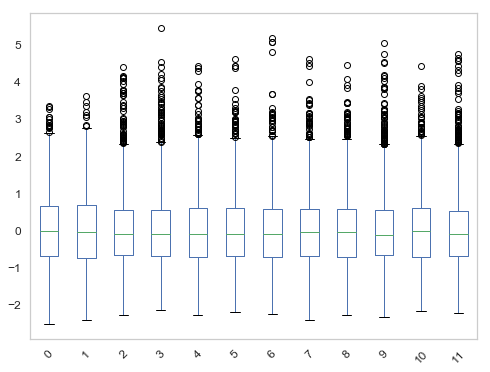

In [28]:
# Boxplot pitches_avg
df_pitches_avg_standard.boxplot(grid=False, rot=45, fontsize=12)

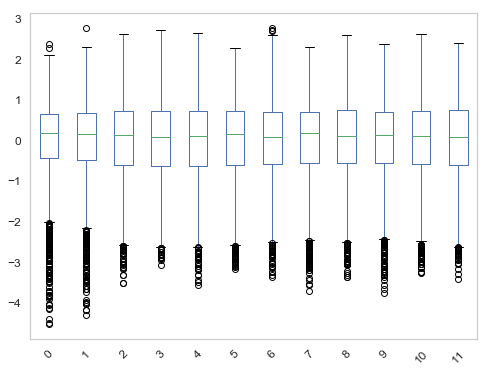

In [29]:
# Boxplot pitches_std
df_pitches_std_standard.boxplot(grid=False, rot=45, fontsize=12)

## Normalización

In [30]:
## Normalizar el dataset Estandarizado
nnor = Normalizer()
df_timbres_avg_norm = pd.DataFrame(nnor.fit_transform(df_timbres_avg_standard), index=df_timbres_avg_standard.index, columns=df_timbres_avg_standard.columns)
df_timbres_std_norm = pd.DataFrame(nnor.fit_transform(df_timbres_std_standard), index=df_timbres_std_standard.index, columns=df_timbres_std_standard.columns)
df_pitches_avg_norm = pd.DataFrame(nnor.fit_transform(df_pitches_avg_standard), index=df_pitches_avg_standard.index, columns=df_pitches_avg_standard.columns)
df_pitches_std_norm = pd.DataFrame(nnor.fit_transform(df_pitches_std_standard), index=df_pitches_std_standard.index, columns=df_pitches_std_standard.columns)

### Scatter

#### Concateno con la metadata y utilizo el genero para generar el scatter

In [31]:
## Agrego el Género a los features
timbres_avg_genre_norm = pd.concat([df_timbres_avg_norm,metadata_clean.genre],axis=1,sort=True,join="inner")
timbres_std_genre_norm = pd.concat([df_timbres_std_norm,metadata_clean.genre],axis=1,sort=True,join="inner")
pitches_avg_genre_norm = pd.concat([df_pitches_avg_norm,metadata_clean.genre],axis=1,sort=True,join="inner")
pitches_std_genre_norm = pd.concat([df_pitches_std_norm,metadata_clean.genre],axis=1,sort=True,join="inner")

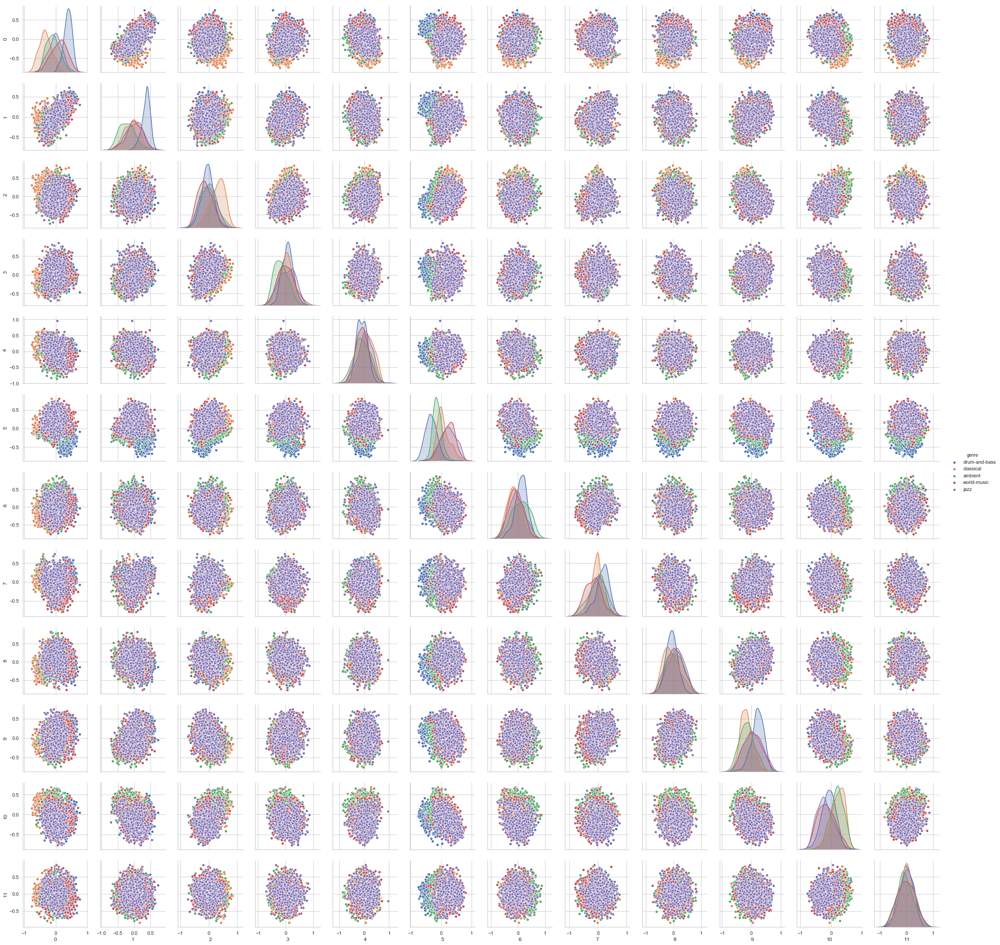

In [32]:
# Scatter timbres_avg_norm
sns.set(style="whitegrid")
sns.pairplot(timbres_avg_genre_norm,hue='genre');

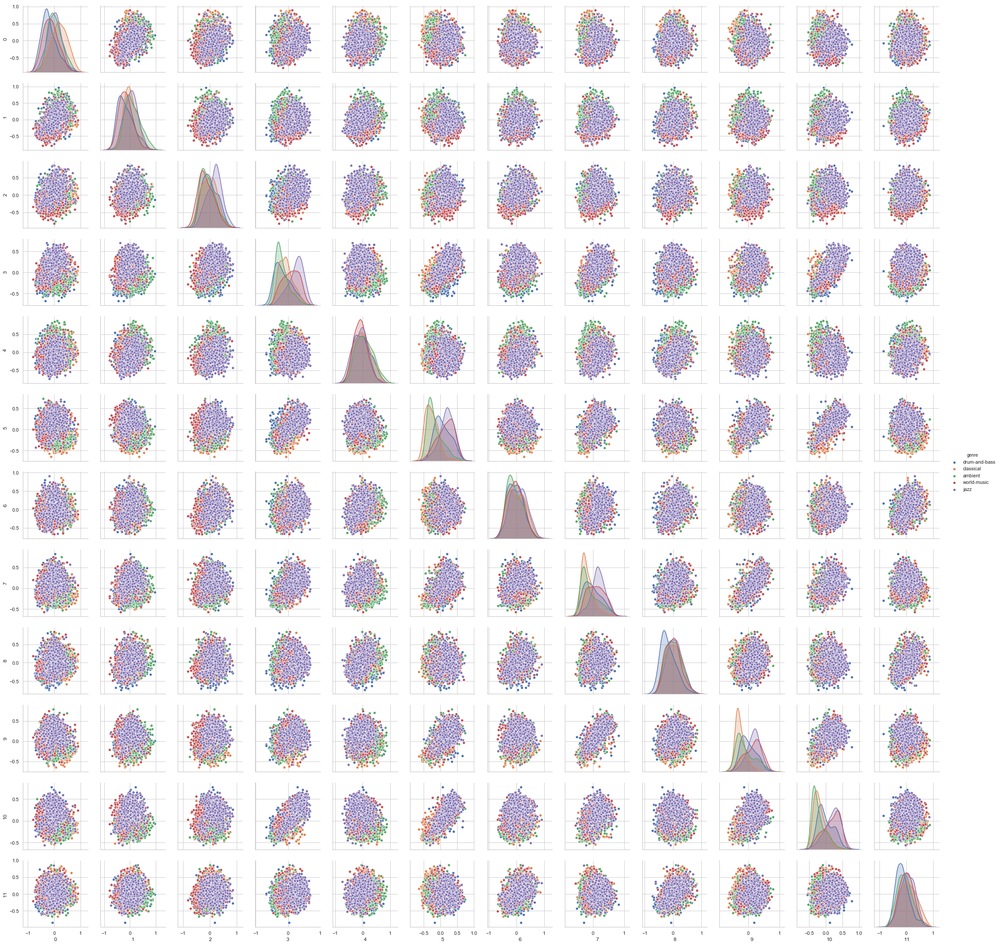

In [33]:
# Scatter timbres_std_norm
sns.set(style="whitegrid")
sns.pairplot(timbres_std_genre_norm,hue='genre');

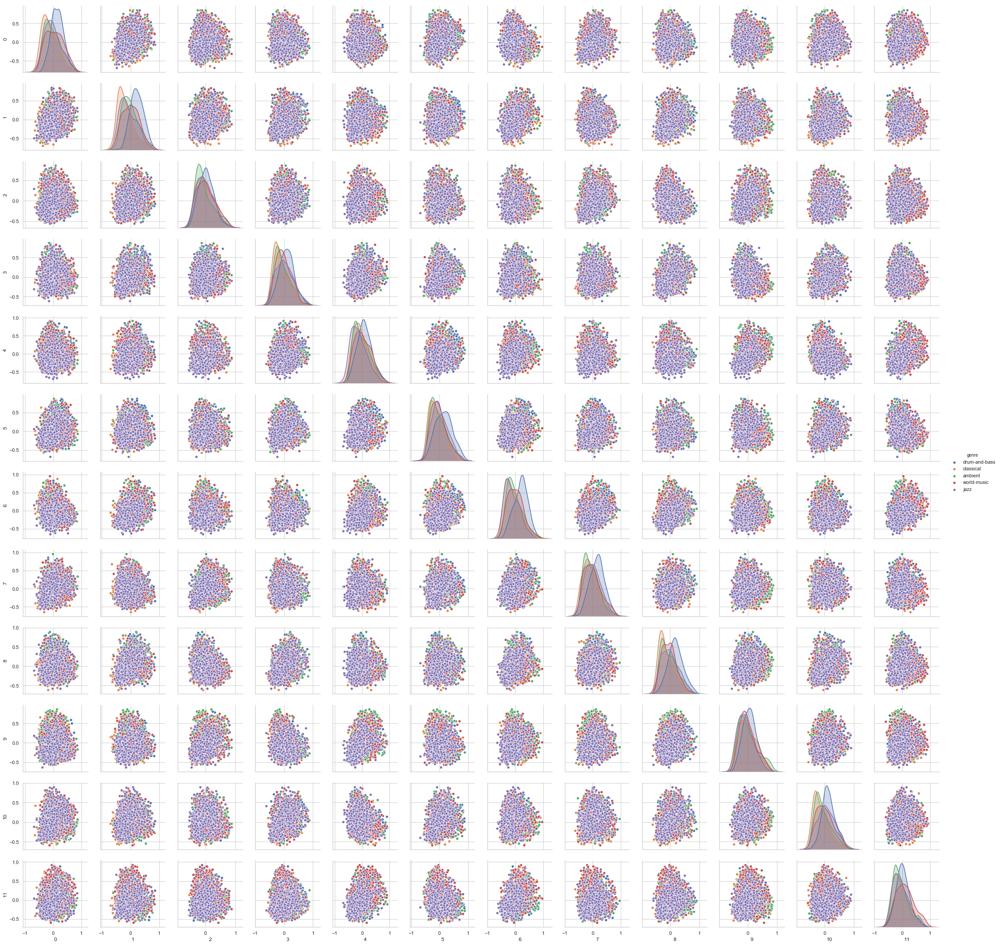

In [34]:
# Scatter pitches_avg_norm
sns.set(style="whitegrid")
sns.pairplot(pitches_avg_genre_norm,hue='genre');

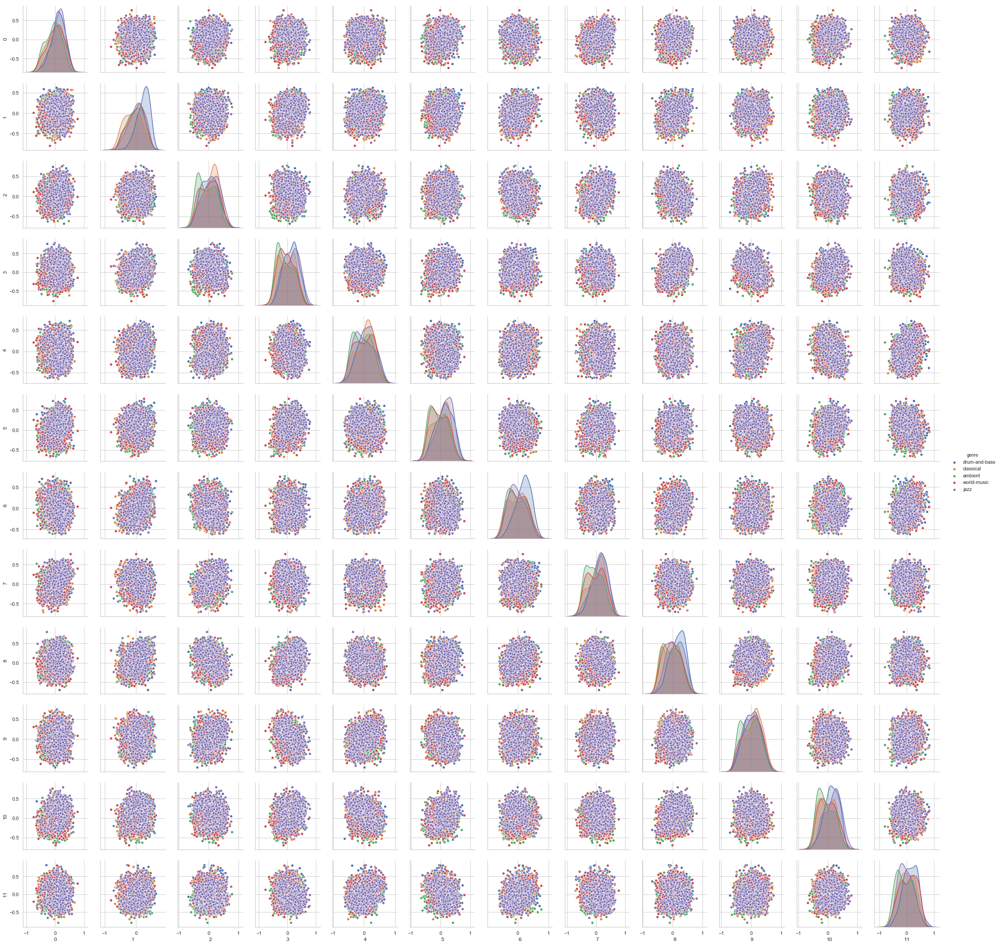

In [35]:
# Scatter pitches_std_nomr
sns.set(style="whitegrid")
sns.pairplot(pitches_std_genre_norm,hue='genre');

### Boxplot

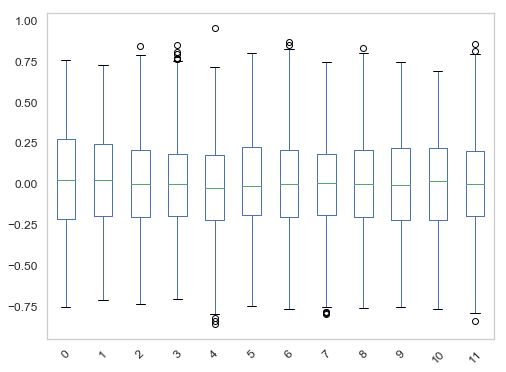

In [36]:
# Boxplot df_timbres_avg
df_timbres_avg_norm.boxplot(grid=False, rot=45, fontsize=12)

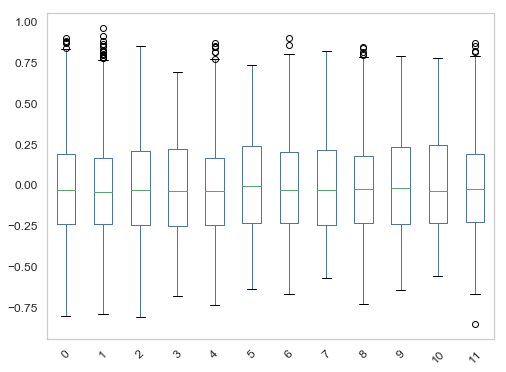

In [37]:
# Boxplot df_timbres_std
df_timbres_std_norm.boxplot(grid=False, rot=45, fontsize=12)

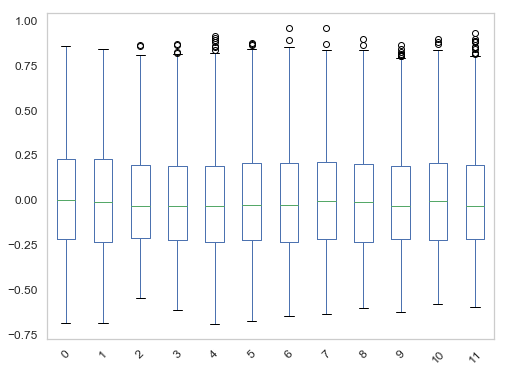

In [38]:
# Boxplot df_pitches_avg
df_pitches_avg_norm.boxplot(grid=False, rot=45, fontsize=12)

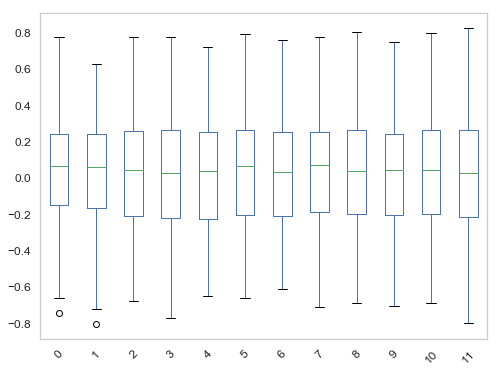

In [39]:
# Boxplot df_pitches_std
df_pitches_std_norm.boxplot(grid=False, rot=45, fontsize=12)

## Breve análisis de los datos

**BoxPlot**: Luego de realizar un analisis sobre los graficos de boxPlot tanto para los pitches como para los timbres luego de ser normalizados, podemos ver que si bien los datos en los timbres tienen mas datos alejados del limite de los bigotes que el de los pitches, en ningun caso se observa datos extremos que ameriten su remoción del dataSet.

**Scatter matrix**: Teniendo en cuenta que las variables de las canciones representan las notas músicales a priori no vemos ninguna que domine al resto y aporte más información ya que en principio no parecerían estar muy relacionadas. Se debería realizar otro tipo de análisis más completo para poder indentificar aquellas que más información aporten.